## Generate subgraph from recommandation path

In [5]:
%run /home/LafiscaL/TRAIL_2023/RippleNet-PyTorch/src/subgraph_generation.ipynb


In [3]:
# Define required dictionnaries
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import os

dirpath = "/home/LafiscaL/TRAIL_2023/rep-path-reasoning-recsys"
os.chdir(dirpath)

# Load the data
data_dir = "data/ml1m/preprocessed/"
kg = pd.read_csv(data_dir+'kg_final.txt', sep='\t', names=['entity_head', 'relation', 'entity_tail'])
users = pd.read_csv(data_dir+'users.txt', sep='\t', names=['uid', 'gender', 'age'])
ratings = pd.read_csv(data_dir+'ratings.txt', sep='\t', names=['uid', 'pid', 'rating', 'timestamp'])
e_map = pd.read_csv(data_dir+'e_map.txt', sep='\t', names=['eid', 'name', 'entity'])
r_map = pd.read_csv(data_dir+'r_map.txt', sep='\t', names=['id', 'kb_relation', 'name'])

# Creating a dictionary for entity names and relations
entity_dict = e_map.set_index('eid').to_dict()['name']
relation_dict = r_map.set_index('id').to_dict()['name']

# Create dictionaries for quick lookup
kg_dict = {}
for _, row in kg.iterrows():
    head, relation, tail = row['entity_head'], row['relation'], row['entity_tail']
    if head not in kg_dict:
        kg_dict[head] = []
    kg_dict[head].append((relation, tail))

ratings_dict = {}
for _, row in ratings.iterrows():
    uid, pid, rating = row['uid'], row['pid'], row['rating']
    if uid != 'uid':
        uid = int(uid)
    if uid not in ratings_dict:
        ratings_dict[uid] = []
    ratings_dict[uid].append((pid, rating))
    
# Read the mapping file to map the movie IDs
mapping_dict = {}
with open("data/ml1m/preprocessed/pgpr/mappings/product_mapping.txt", "r") as file:
    next(file)  # Skip the header
    for line in file:
        rating_id, new_id = line.strip().split("\t")
        mapping_dict[int(new_id)] = int(rating_id)


/tmp/ipykernel_2724501/68883228.py:14: DtypeWarning: Columns (0,1,2,3) have mixed types. Specify dtype option on import or set low_memory=False.
  ratings = pd.read_csv(data_dir+'ratings.txt', sep='\t', names=['uid', 'pid', 'rating', 'timestamp'])


In [4]:
# Define the targeted recommandation path
recommendation_path = [('self_loop', 'user', 0), ('watched', 'product', 1930),
                       ('watched', 'user', 3914), ('watched', 'product', 2585)]


Node: Warner_Bros., PageRank Score: 0.0036
Node: Paramount_Pictures, PageRank Score: 0.0035
Node: Walt_Disney_Studios_Motion_Pictures, PageRank Score: 0.0033
Node: Germany, PageRank Score: 0.0032
Node: Philippe_Sarde, PageRank Score: 0.0030
Node: John_Williams, PageRank Score: 0.0029
Node: 20th_Century_Fox, PageRank Score: 0.0029
Node: Walt_Disney_Animation_Studios, PageRank Score: 0.0028
Node: Elmer_Bernstein, PageRank Score: 0.0028
Node: Metro-Goldwyn-Mayer, PageRank Score: 0.0028
Node: Walt_Disney_Pictures, PageRank Score: 0.0027
Node: Universal_Studios, PageRank Score: 0.0027
Node: Randy_Newman, PageRank Score: 0.0025
Node: RKO_Pictures, PageRank Score: 0.0025
Node: United_States, PageRank Score: 0.0024
Node: Amblin_Entertainment, PageRank Score: 0.0024
Node: Columbia_Pictures, PageRank Score: 0.0024
Node: Frank_Churchill, PageRank Score: 0.0023
Node: BBC, PageRank Score: 0.0023
Node: Peter_Sallis, PageRank Score: 0.0023
Node: Alan_Menken, PageRank Score: 0.0023
Node: Michael_Kahn_

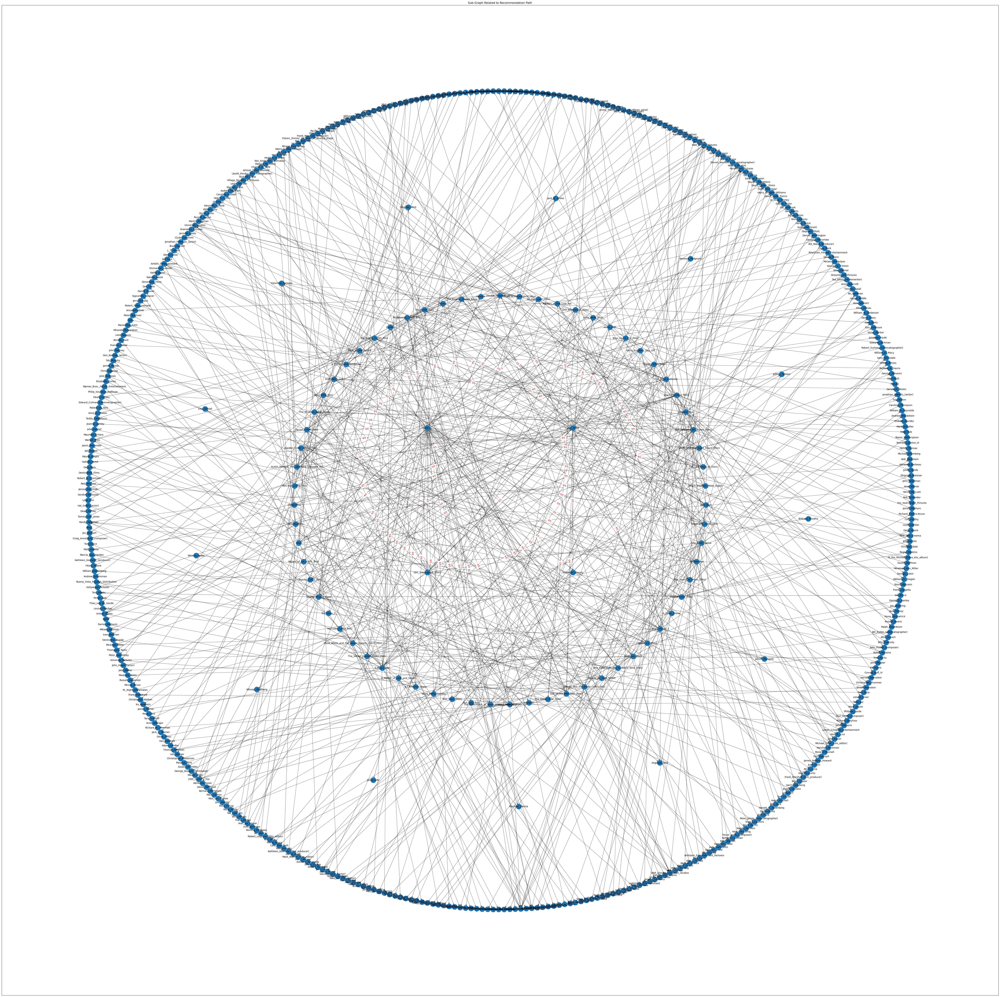

In [6]:
G, primary_nodes, secondary_nodes, tertiary_nodes = create_subgraph(recommendation_path, entity_dict=entity_dict,
                                                                    relation_dict=relation_dict, kg_dict=kg_dict,
                                                                    ratings_dict=ratings_dict)

print('PageRank scores:')
scores = pagerank_subgraph(G)

plot_subgraph(G, primary_nodes, secondary_nodes, tertiary_nodes, last_hop=True, scores=scores)